<a href="https://colab.research.google.com/github/9645258/aiffel/blob/main/01_exploration/%5BE-16%5Dexploration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **🎄 EXPLORATION 16**  

# **🌲 EXPLORATION 16-1 : Segmentation map으로 도로 이미지 만들기**

## **🌿 01_데이터 준비**

### **🍃 01-1_필요 라이브러리 import**

In [ ]:
import os
import cv2
import glob
import time
import imageio
import numpy as np
from IPython import display
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import data
from tensorflow import image
import tensorflow_datasets as tfds
from tensorflow.keras import losses
from tensorflow.keras import optimizers
from tensorflow.keras import layers, Input, Model
from tensorflow.keras.preprocessing.image import random_rotation

### **🍃 01-2_필요 데이터 import**

In [ ]:
data_dir = "C:/Users/96452/00_work/E-16/data"

In [ ]:
train_path = os.path.join(data_dir, 'train/')
test_path = os.path.join(data_dir, 'val/')

## **🌿 02_데이터 확인**

### **🍃 02-1_데이터 샘플 수 확인**

In [ ]:
print("number of train examples :", len(os.listdir(train_path)))
print("number of train examples :", len(os.listdir(test_path)))

number of train examples : 1000
number of train examples : 5


### **🍃 02-2_데이터 시각화**

- **학습 데이터에서 임의로 6장을 가져와 시각화**

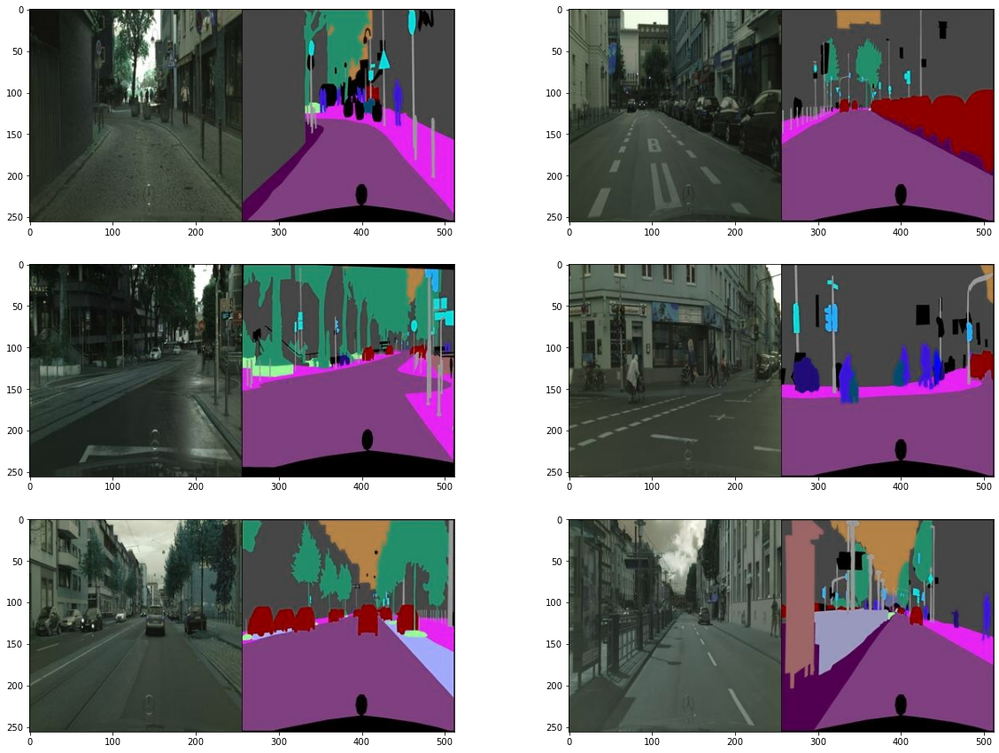

In [ ]:
plt.figure(figsize=(20,15))
for i in range(1, 7):
    f = train_path + os.listdir(train_path)[np.random.randint(800)]
    img = cv2.imread(f, cv2.IMREAD_COLOR)
    plt.subplot(3,2,i)
    plt.imshow(img)

### **🍃 02-3_이미지 크기 확인**

In [ ]:
f = train_path + os.listdir(train_path)[0]
img = cv2.imread(f, cv2.IMREAD_COLOR)
print(img.shape)

(256, 512, 3)


## **🌿 03_Augmentation**

### **🍃 03-1_이미지 분리**

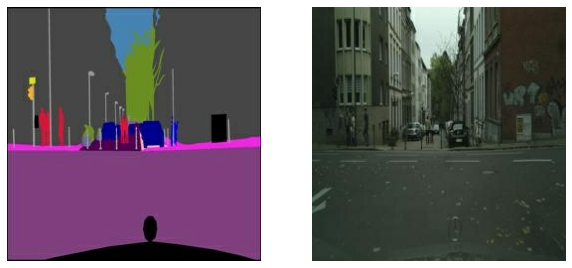

In [ ]:
def normalize(x):
    x = tf.cast(x, tf.float32)
    return (x/127.5) - 1

def denormalize(x):
    x = (x+1)*127.5
    x = x.numpy()
    return x.astype(np.uint8)

def load_img(img_path):
    img = tf.io.read_file(img_path)
    img = tf.image.decode_image(img, 3)
    
    w = tf.shape(img)[1] // 2
    real_image = img[:, :w, :] 
    real_image = tf.cast(real_image, tf.float32)
    input_image = img[:, w:, :] 
    input_image = tf.cast(input_image, tf.float32)
    return normalize(input_image), normalize(real_image)

f = train_path + os.listdir(train_path)[1]
input_image, real_image = load_img(f)

plt.figure(figsize=(10,7))
plt.subplot(1,2,1); plt.axis('off'); plt.imshow(denormalize(input_image))
plt.subplot(1,2,2); plt.axis('off'); plt.imshow(denormalize(real_image))

### **🍃 03-2_Augmentation 적용**

In [ ]:
@tf.function()
def apply_augmentation(sketch, colored):
    stacked = tf.concat([sketch, colored], axis=-1)
    
    _pad = tf.constant([[30,30],[30,30],[0,0]])
    if tf.random.uniform(()) < .5:
        padded = tf.pad(stacked, _pad, "REFLECT")
    else:
        padded = tf.pad(stacked, _pad, "CONSTANT", constant_values=1.)

    out = image.random_crop(padded, size=[256, 256, 6])
    
    out = image.random_flip_left_right(out)
    out = image.random_flip_up_down(out)
    
    if tf.random.uniform(()) < .5:
        degree = tf.random.uniform([], minval=1, maxval=4, dtype=tf.int32)
        out = image.rot90(out, k=degree)
    
    return out[...,:3], out[...,3:]

### **🍃 03-3_Augmentation 적용 후 시각화**

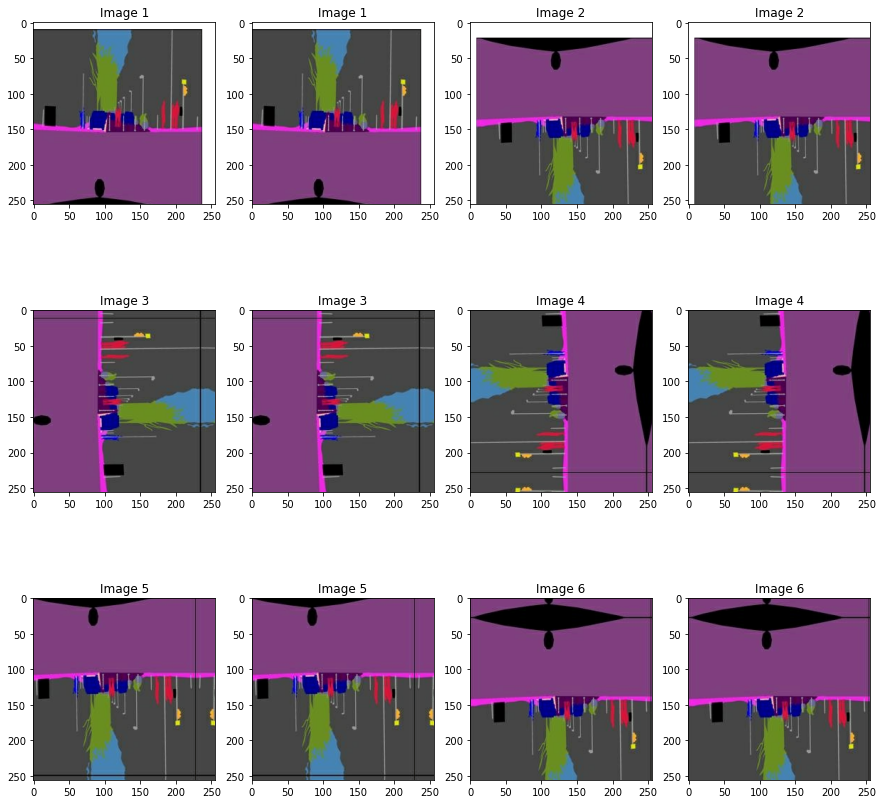

In [ ]:
plt.figure(figsize=(15,15))

img_n = 1

for i in range(1, 13, 2):
    augmented_input, augmented_real = apply_augmentation(input_image, real_image)
    
    plt.subplot(3,4,i)
    plt.imshow(denormalize(augmented_input)); plt.title(f"Image {img_n}")
    plt.subplot(3,4,i+1); 
    plt.imshow(denormalize(augmented_input)); plt.title(f"Image {img_n}")
    img_n += 1

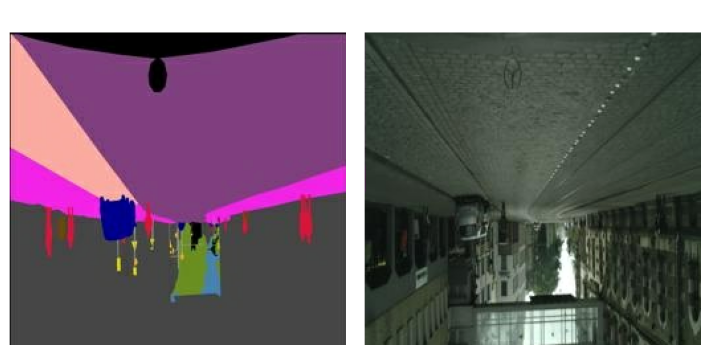

In [ ]:
def get_train(img_path):
    input_image, real_image = load_img(img_path)
    input_image, real_image = apply_augmentation(input_image, real_image)
    return input_image, real_image

train_images = data.Dataset.list_files(train_path + "*.jpg")
train_images = train_images.map(get_train).shuffle(100).batch(4)

sample = train_images.take(1)
sample = list(sample.as_numpy_iterator())
input_image, real_image = (sample[0][0]+1)*127.5, (sample[0][1]+1)*127.5

plt.figure(figsize=(10,5))
plt.subplot(1,2,1); plt.axis('off'); plt.imshow(input_image[0].astype(np.uint8))
plt.subplot(1,2,2); plt.axis('off'); plt.imshow(real_image[0].astype(np.uint8))
plt.tight_layout()

## **🌿 04_모델 구성**

### **🍃 04-1_EncodeBlock, DecodeBlock 구성**

In [ ]:
class EncodeBlock(layers.Layer):
    def __init__(self, n_filters, use_bn=True):
        super(EncodeBlock, self).__init__()
        self.use_bn = use_bn       
        self.conv = layers.Conv2D(n_filters, 4, 2, "same", use_bias=False)
        self.batchnorm = layers.BatchNormalization()
        self.lrelu = layers.LeakyReLU(0.2)

    def call(self, x):
        x = self.conv(x)
        if self.use_bn:
            x = self.batchnorm(x)
        return self.lrelu(x)

    
class DecodeBlock(layers.Layer):
    def __init__(self, f, dropout=True):
        super(DecodeBlock, self).__init__()
        self.dropout = dropout
        self.Transconv = layers.Conv2DTranspose(f, 4, 2, "same", use_bias=False)
        self.batchnorm = layers.BatchNormalization()
        self.relu = layers.ReLU()
        
    def call(self, x):
        x = self.Transconv(x)
        x = self.batchnorm(x)
        if self.dropout:
            x = layers.Dropout(.5)(x)
        return self.relu(x)

### **🍃 04-2_UNetGenerator 구성**

In [ ]:
class UNetGenerator(Model):
    def __init__(self):
        super(UNetGenerator, self).__init__()
        encode_filters = [64,128,256,512,512,512,512,512]
        decode_filters = [512,512,512,512,256,128,64]
        
        self.encode_blocks = []
        for i, f in enumerate(encode_filters):
            if i == 0:
                self.encode_blocks.append(EncodeBlock(f, use_bn=False))
            else:
                self.encode_blocks.append(EncodeBlock(f))
        
        self.decode_blocks = []
        for i, f in enumerate(decode_filters):
            if i < 3:
                self.decode_blocks.append(DecodeBlock(f))
            else:
                self.decode_blocks.append(DecodeBlock(f, dropout=False))
        
        self.last_conv = layers.Conv2DTranspose(3, 4, 2, "same", use_bias=False)
    
    def call(self, x):
        features = []
        for block in self.encode_blocks:
            x = block(x)
            features.append(x)
        
        features = features[:-1]
                    
        for block, feat in zip(self.decode_blocks, features[::-1]):
            x = block(x)
            x = layers.Concatenate()([x, feat])
        
        x = self.last_conv(x)
        return x
                
    def get_summary(self, input_shape=(256,256,3)):
        inputs = Input(input_shape)
        return Model(inputs, self.call(inputs)).summary()

### **🍃 04-3_Generator 정보 확인**

In [ ]:
generator = UNetGenerator()
generator.get_summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
encode_block (EncodeBlock)      (None, 128, 128, 64) 3072        input_1[0][0]                    
__________________________________________________________________________________________________
encode_block_1 (EncodeBlock)    (None, 64, 64, 128)  131584      encode_block[0][0]               
__________________________________________________________________________________________________
encode_block_2 (EncodeBlock)    (None, 32, 32, 256)  525312      encode_block_1[0][0]             
______________________________________________________________________________________________

### **🍃 04-4_DiscBlock 구성**

In [ ]:
class DiscBlock(layers.Layer):
    def __init__(self, n_filters, stride=2, custom_pad=False, use_bn=True, act=True):
        super(DiscBlock, self).__init__()
        self.custom_pad = custom_pad
        self.use_bn = use_bn
        self.act = act
        
        if custom_pad:
            self.padding = layers.ZeroPadding2D()
            self.conv = layers.Conv2D(n_filters, 4, stride, "valid", use_bias=False)
        else:
            self.conv = layers.Conv2D(n_filters, 4, stride, "same", use_bias=False)
        
        self.batchnorm = layers.BatchNormalization() if use_bn else None
        self.lrelu = layers.LeakyReLU(0.2) if act else None
        
    def call(self, x):
        if self.custom_pad:
            x = self.padding(x)
            x = self.conv(x)
        else:
            x = self.conv(x)
                
        if self.use_bn:
            x = self.batchnorm(x)
            
        if self.act:
            x = self.lrelu(x)
        return x 

### **🍃 04-5_Discriminator 구성**

In [ ]:
class Discriminator(Model):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.block1 = layers.Concatenate()
        self.block2 = DiscBlock(n_filters=64, stride=2, custom_pad=False, use_bn=False, act=True)
        self.block3 = DiscBlock(n_filters=128, stride=2, custom_pad=False, use_bn=True, act=True)
        self.block4 = DiscBlock(n_filters=256, stride=2, custom_pad=False, use_bn=True, act=True)
        self.block5 = DiscBlock(n_filters=512, stride=1, custom_pad=True, use_bn=True, act=True)
        self.block6 = DiscBlock(n_filters=1, stride=1, custom_pad=True, use_bn=False, act=False)
        self.sigmoid = layers.Activation("sigmoid")
        
        # filters = [64,128,256,512,1]
        # self.blocks = [layers.Concatenate()]
        # for i, f in enumerate(filters):
        #     self.blocks.append(DiscBlock(
        #         n_filters=f,
        #         strides=2 if i<3 else 1,
        #         custom_pad=False if i<3 else True,
        #         use_bn=False if i==0 and i==4 else True,
        #         act=True if i<4 else False
        #     ))
    
    def call(self, x, y):
        out = self.block1([x, y])
        out = self.block2(out)
        out = self.block3(out)
        out = self.block4(out)
        out = self.block5(out)
        out = self.block6(out)
        return self.sigmoid(out)
    
    def get_summary(self, x_shape=(256,256,3), y_shape=(256,256,3)):
        x, y = Input(x_shape), Input(y_shape) 
        return Model((x, y), self.call(x, y)).summary()

### **🍃 04-6_Discriminator 정보 확인**

In [ ]:
discriminator = Discriminator()
discriminator.get_summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
input_3 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
concatenate_7 (Concatenate)     (None, 256, 256, 6)  0           input_2[0][0]                    
                                                                 input_3[0][0]                    
__________________________________________________________________________________________________
disc_block (DiscBlock)          (None, 128, 128, 64) 6144        concatenate_7[0][0]        

### **🍃 04-7_손실 함수**

In [ ]:
bce = losses.BinaryCrossentropy(from_logits=False)
mae = losses.MeanAbsoluteError()

def get_gene_loss(fake_output, real_output, fake_disc):
    l1_loss = mae(real_output, fake_output)
    gene_loss = bce(tf.ones_like(fake_disc), fake_disc)
    return gene_loss, l1_loss

def get_disc_loss(fake_disc, real_disc):
    return bce(tf.zeros_like(fake_disc), fake_disc) + bce(tf.ones_like(real_disc), real_disc)

### **🍃 04-8_Optimizer**

In [ ]:
gene_opt = optimizers.Adam(2e-4, beta_1=.5, beta_2=.999)
disc_opt = optimizers.Adam(2e-4, beta_1=.5, beta_2=.999)

### **🍃 04-9_가중치 업데이트 구성 함수**

- **1개 배치 데이터 입력 시 가중치 1회 업데이트**

In [ ]:
@tf.function
def train_step(sketch, real_colored):
    with tf.GradientTape() as gene_tape, tf.GradientTape() as disc_tape:
        # Generator 예측
        fake_colored = generator(sketch, training=True)
        # Discriminator 예측
        fake_disc = discriminator(sketch, fake_colored, training=True)
        real_disc = discriminator(sketch, real_colored, training=True)
        # Generator 손실 계산
        gene_loss, l1_loss = get_gene_loss(fake_colored, real_colored, fake_disc)
        gene_total_loss = gene_loss + (100 * l1_loss) ## <===== L1 손실 반영 λ=100
        # Discrminator 손실 계산
        disc_loss = get_disc_loss(fake_disc, real_disc)
                
    gene_gradient = gene_tape.gradient(gene_total_loss, generator.trainable_variables)
    disc_gradient = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    gene_opt.apply_gradients(zip(gene_gradient, generator.trainable_variables))
    disc_opt.apply_gradients(zip(disc_gradient, discriminator.trainable_variables))
    return gene_loss, l1_loss, disc_loss

### **🍃 04-10_생성 이미지 저장 함수**

In [ ]:
def generate_and_save_images(model, epoch, it, save_file_num=1):

    plt.figure(figsize=(15,15))
    for train_idx in range(len(os.listdir(train_path))//10):
        f = train_path + os.listdir(train_path)[train_idx]
        input_image, real_image = load_img(f)

        pred = generator(tf.expand_dims(input_image, 0))
        pred = denormalize(pred)

        plt.subplot(10, 10, train_idx+1)  # 100개 sample 이라서 10행 10열로 시각화
        plt.imshow(pred[0])
        plt.axis('off')

    plt.tight_layout()  # subplot 간격 자동 조절(겹치지 않게)

    save_file_path = os.path.join(data_dir, 'generated_samples/sample_{}'.format(save_file_num))
    if not os.path.exists(save_file_path):
        os.makedirs(save_file_path)
    
    save_file_path = os.path.join(save_file_path, 'sample_epoch_{:04d}_iter_{:03d}.png'.format(epoch, it))
    plt.savefig(save_file_path)  # 이미지 저장

    plt.show()

### **🍃 04-11_History 시각화 함수**

In [ ]:
def draw_train_history(history, epoch, save_file_num=1):
    plt.figure(figsize=(15,15))

    plt.subplot(411)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')

    plt.subplot(412)  
    plt.plot(history['gen_loss'], 'tab:blue')   
    plt.title('gen_loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss'], loc='upper left')

    plt.subplot(413)  
    plt.plot(history['l1_loss'], 'tab:green')   
    plt.title('l1_loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['l1_loss'], loc='upper left')  

    plt.subplot(414)  
    plt.plot(history['disc_loss'], 'tab:orange')   
    plt.title('disc_loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['disc_loss'], loc='upper left')  

    plt.tight_layout()  # subplot 간격 자동 조절(겹치지 않게)

    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    save_file_path = os.path.join(data_dir, 'training_history/training_history_{}'.format(save_file_num))
    if not os.path.exists(save_file_path):
        os.makedirs(save_file_path)
    
    save_file_path = os.path.join(save_file_path, 'training_history_{:04d}.png'.format(epoch))
    plt.savefig(save_file_path)  # 이미지 저장

    plt.show()

### **🍃 04-12_체크 포인트 설정**

In [ ]:
checkpoint = tf.train.Checkpoint(generator_optimizer=gene_opt,
                                 discriminator_optimizer=disc_opt,
                                 generator=generator,
                                 discriminator=discriminator)

### **🍃 04-13_체크 포인트 이미지 시각화 함수**

In [ ]:
def draw_training_checkpoints_image(save_file_num=1):
    checkpoint_dir = os.path.join(data_dir, 'training_checkpoints/training_checkpoints_{}'.format(save_file_num))
    latest = tf.train.latest_checkpoint(checkpoint_dir)
    checkpoint.restore(latest)

    generator = checkpoint.generator
    discriminator = checkpoint.discriminator

    for test_idx in range(len(os.listdir(test_path))):
        f = test_path + os.listdir(test_path)[test_idx]
        input_image, real_image = load_img(f)

        pred = generator(tf.expand_dims(input_image, 0))
        pred = denormalize(pred)

        plt.figure(figsize=(20,10))
        
        plt.subplot(1,3,1); plt.axis('off'); plt.imshow(denormalize(input_image)); plt.title('Input Image')
        plt.subplot(1,3,2); plt.axis('off'); plt.imshow(pred[0]); plt.title('Predicted Image')
        plt.subplot(1,3,3); plt.axis('off'); plt.imshow(denormalize(real_image)); plt.title('Ground Truth')

        plt.tight_layout() 
        plt.show()

### **🍃 04-14_gif 생성 함수**

In [ ]:
def make_a_gif(anim_file_num=1, flag=True):
    if flag:
        anim_file = 'C:/Users/96452/00_work/E-16/data/Pix2Pix_{}.gif'.format(anim_file_num)
        filenames = glob.glob('C:/Users/96452/00_work/E-16/data/generated_samples/sample_{}/sample*.png'.format(anim_file_num))  # Fake Images
    else:
        anim_file = 'C:/Users/96452/00_work/E-16/data/Pix2Pix_history_{}.gif'.format(anim_file_num)
        filenames = glob.glob('C:/Users/96452/00_work/E-16/data/training_history/training_history_{}/training_history*.png'.format(anim_file_num))  # Graphs

    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = sorted(filenames)
        last = -1
        for i, filename in enumerate(filenames):
            frame = 2*(i**0.5)
            if round(frame) > round(last):
                last = frame
            else:
                continue
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

### **🍃 04-15_모델 학습 구성**

In [ ]:
save_every = 5 
EPOCHS = 1000
save_file_num = 1

## **🌿 05_모델 Train 데이터셋 학습**

In [ ]:
def train(dataset, epochs, save_every, save_file_num=1):
    start = time.time()
    history = {'gen_loss':[], 'l1_loss':[], 'disc_loss':[]}
    for epoch in range(1, epochs+1):
        epoch_start = time.time()
        for i, (input_image, ground_truth) in enumerate(train_images):
            g_loss, l1_loss, d_loss = train_step(input_image, ground_truth)
            history['gen_loss'].append(g_loss)
            history['l1_loss'].append(l1_loss)
            history['disc_loss'].append(d_loss)
                    
            if (i+1) % 200 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, i+1, save_file_num)
                print(f"EPOCH[{epoch+1}] - STEP[{i+1}] \
                        \nTime for epoch {epoch} : {int(time.time()-epoch_start)} sec \
                        \nGenerator_loss:{g_loss.numpy():.4f} \
                        \nL1_loss:{l1_loss.numpy():.4f} \
                        \nDiscriminator_loss:{d_loss.numpy():.4f}", end="\n\n")
                
        if (epoch + 1) % save_every == 0:
            checkpoint_dir = os.path.join(data_dir, 'training_checkpoints/training_checkpoints_{}'.format(save_file_num))
            checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, i, save_file_num)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch, save_file_num)

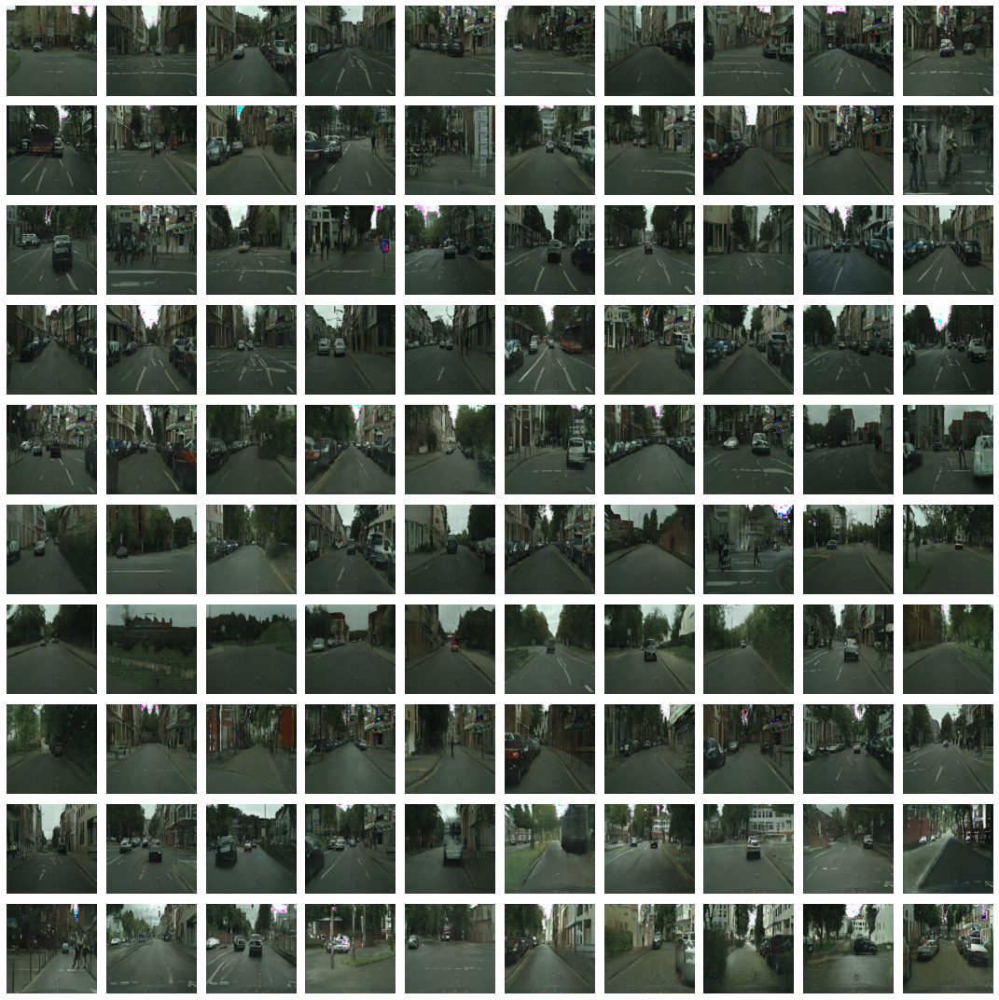

Time for training : 32342 sec


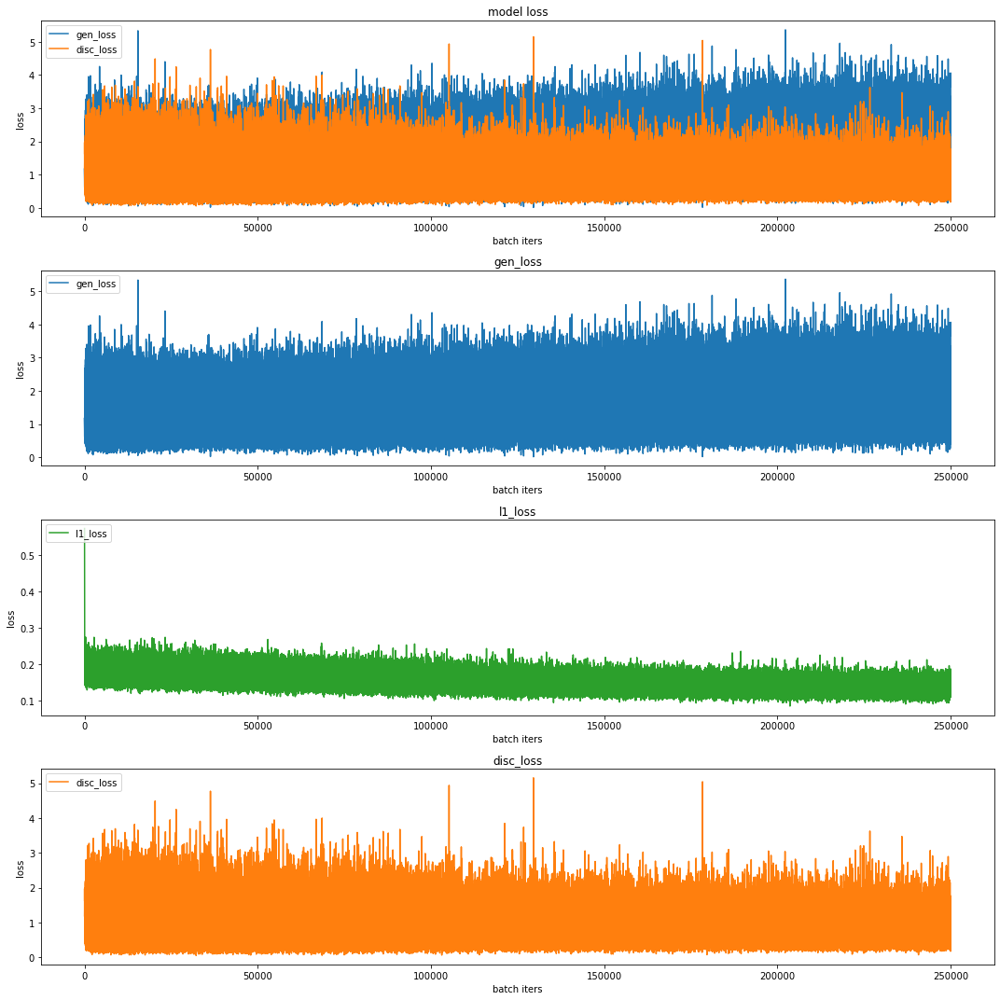

CPU times: total: 8h 58min 36s
Wall time: 8h 59min 9s


In [ ]:
%%time
train(train_images, EPOCHS, save_every, save_file_num)

## **🌿 06_모델 Train 데이터셋 학습 결과 확인**

### **🍃 06-1_도로 이미지 gif 생성**

In [ ]:
make_a_gif(1, True)

C:\Users\96452\AppData\Local\Temp\ipykernel_4928\3649867582.py:18: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_4928\3649867582.py:20: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


[gif 파일 / 너무 커서 업로드 불가](https://drive.google.com/file/d/1ZcNh5LTO6W2txbJNuPBl9yQg01f6qILR/view?usp=sharing)

### **🍃 06-2_History gif 생성**

In [ ]:
make_a_gif(1, False)

C:\Users\96452\AppData\Local\Temp\ipykernel_4928\3649867582.py:18: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_4928\3649867582.py:20: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


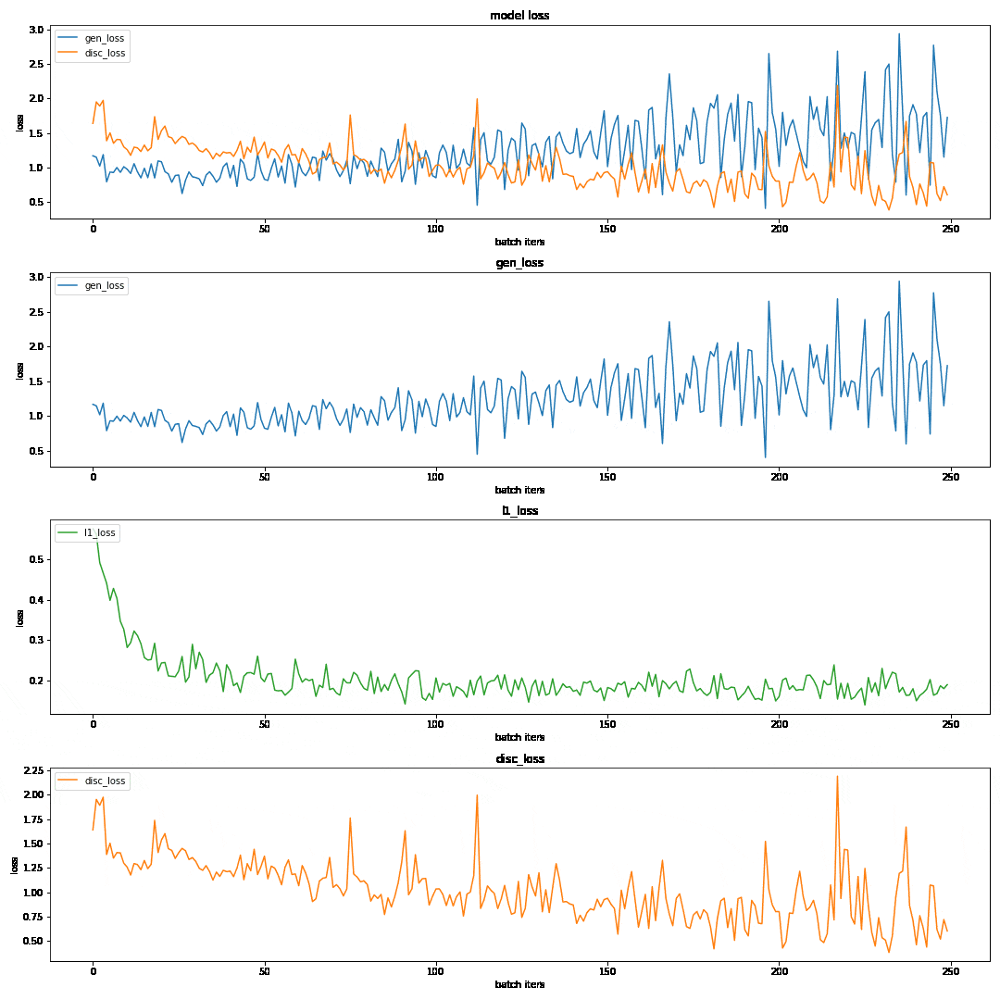

### **🍃 06-3_체크포인트를 활용한 결과 확인**

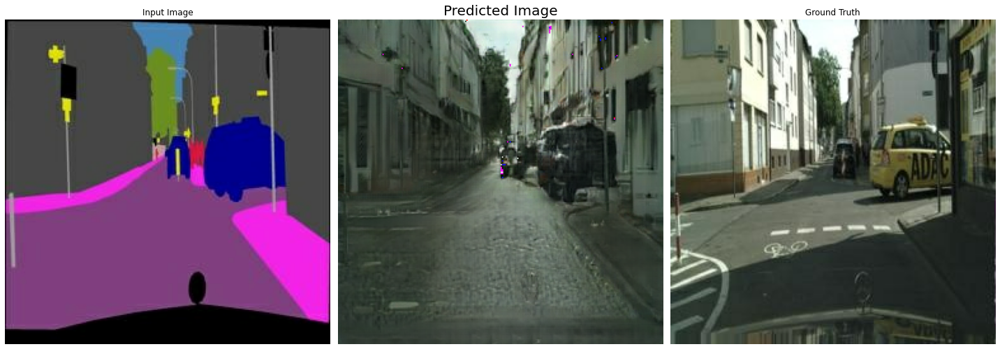

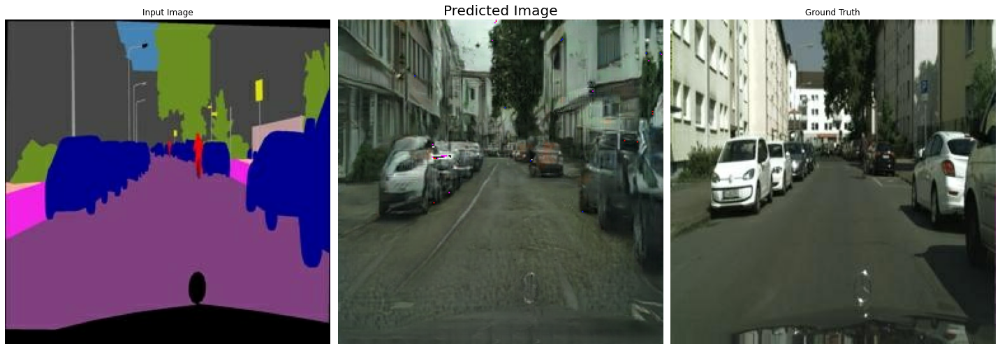

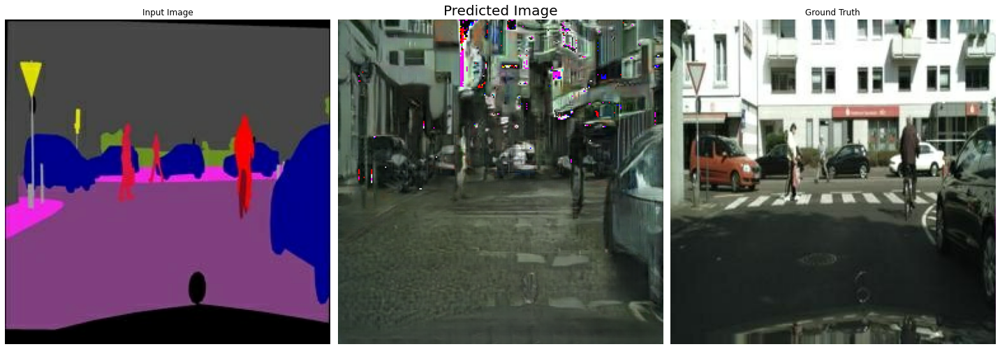

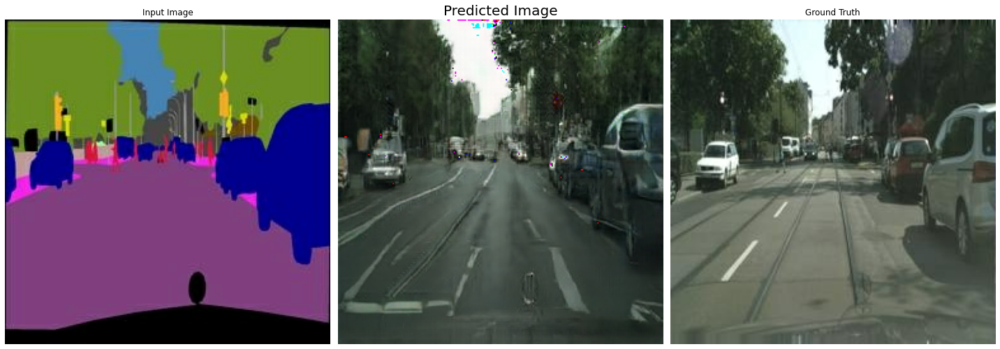

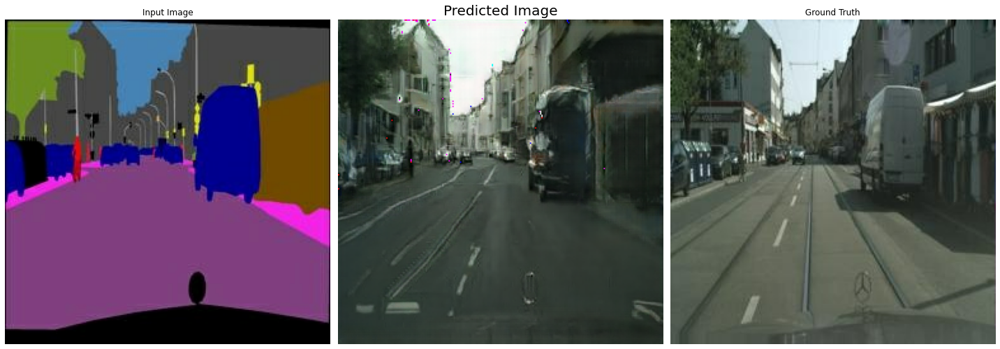

In [ ]:
draw_training_checkpoints_image(1)

## **🌿 07_모델 Test 데이터셋 학습**

In [ ]:
def generate_and_save_images(model, epoch, it, save_file_num=1):

    plt.figure(figsize=(10,5))
    for test_idx in range(len(os.listdir(test_path))):
        f = test_path + os.listdir(test_path)[test_idx]
        input_image, real_image = load_img(f)

        pred = generator(tf.expand_dims(input_image, 0))
        pred = denormalize(pred)

        plt.subplot(1, 5, test_idx+1)
        plt.imshow(pred[0])
        plt.axis('off')

    plt.tight_layout()

    save_file_path = os.path.join(data_dir, 'generated_samples/sample_{}'.format(save_file_num))
    if not os.path.exists(save_file_path):
        os.makedirs(save_file_path)
    
    save_file_path = os.path.join(save_file_path, 'sample_epoch_{:04d}_iter_{:03d}.png'.format(epoch, it))
    plt.savefig(save_file_path)

    plt.show()

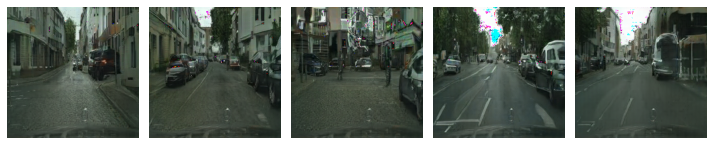

Time for training : 14838 sec


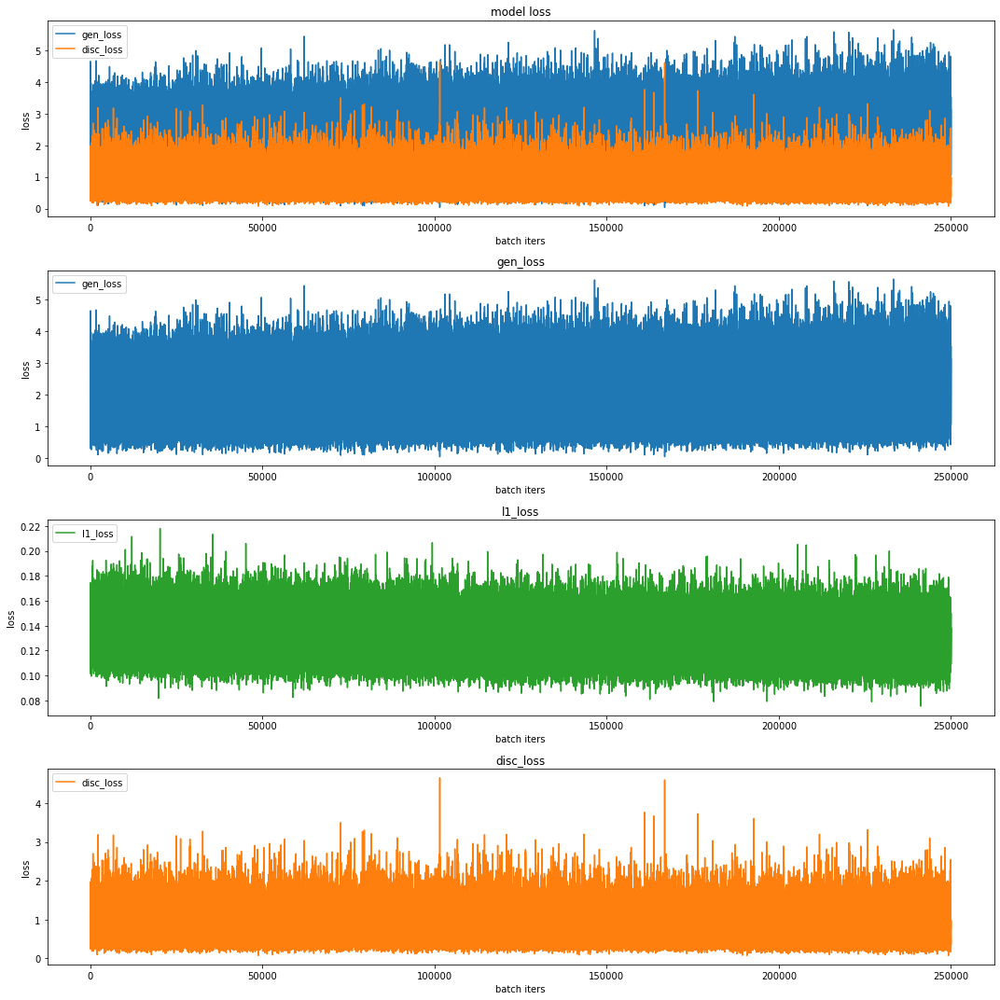

CPU times: total: 4h 8min 19s
Wall time: 4h 7min 25s


In [ ]:
%%time
train(train_images, EPOCHS, save_every, 2)

## **🌿 08_모델 Test 데이터셋 학습 결과 확인**

### **🍃 08-1_도로 이미지 gif 생성**

In [ ]:
make_a_gif(2, True)

C:\Users\96452\AppData\Local\Temp\ipykernel_4928\3649867582.py:18: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_4928\3649867582.py:20: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


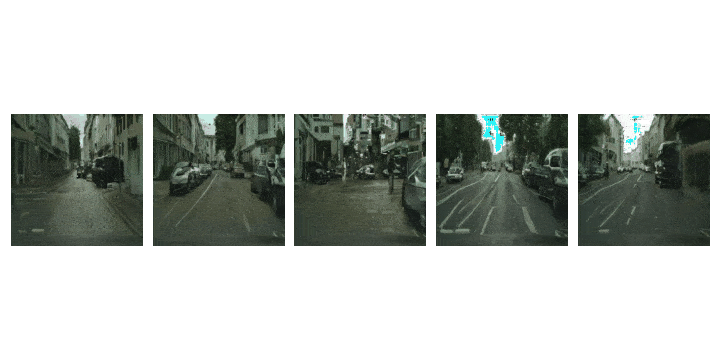

### **🍃 08-2_History gif 생성**

In [ ]:
make_a_gif(2, False)

C:\Users\96452\AppData\Local\Temp\ipykernel_4928\3649867582.py:18: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
C:\Users\96452\AppData\Local\Temp\ipykernel_4928\3649867582.py:20: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


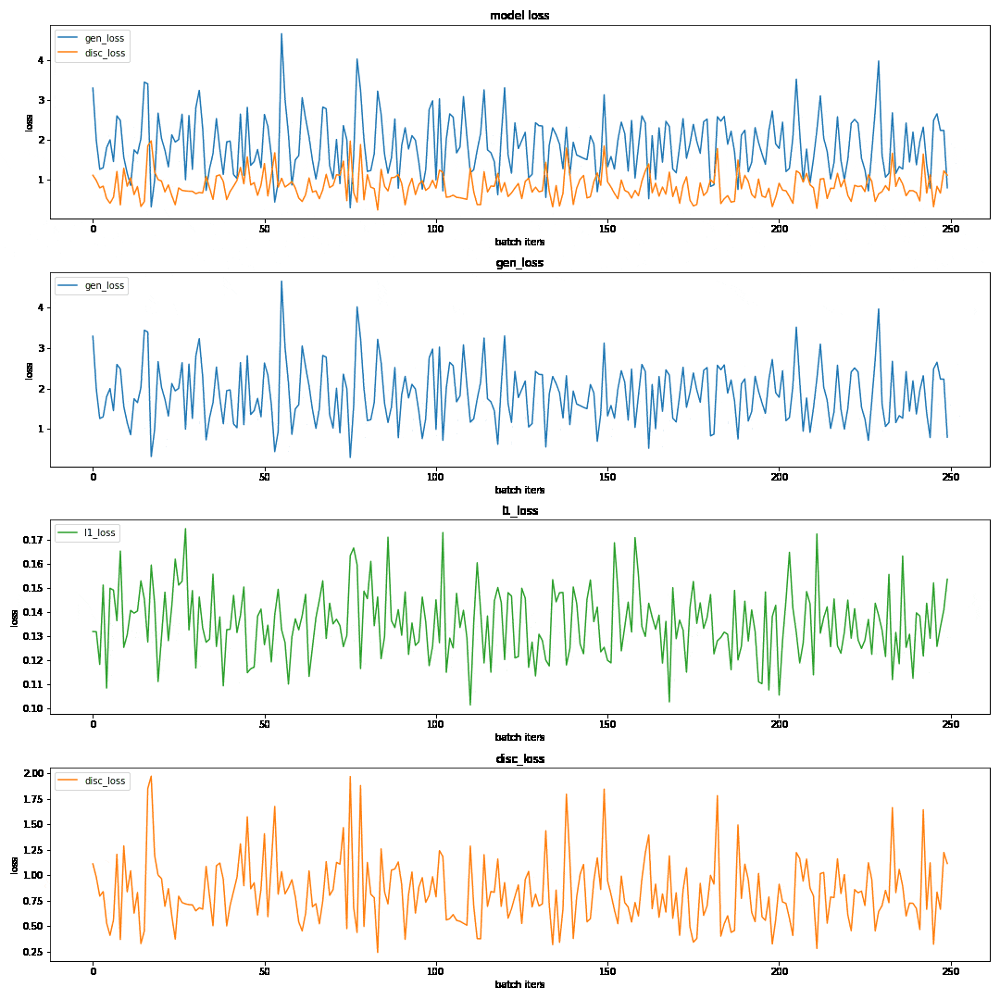

### **🍃 08-3_체크포인트를 활용한 결과 확인**

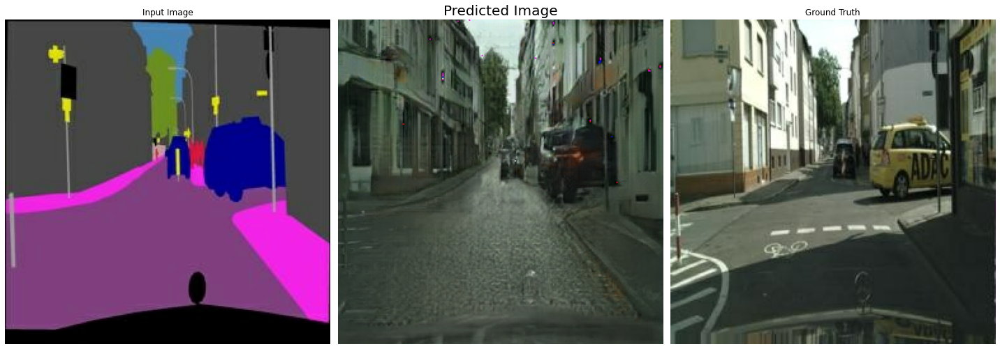

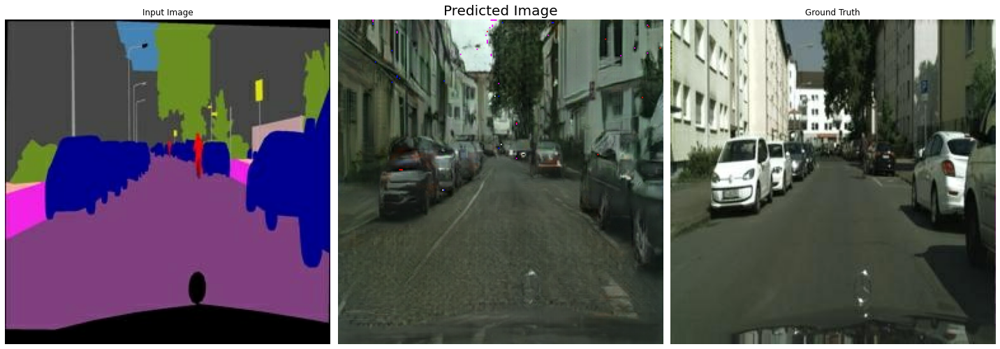

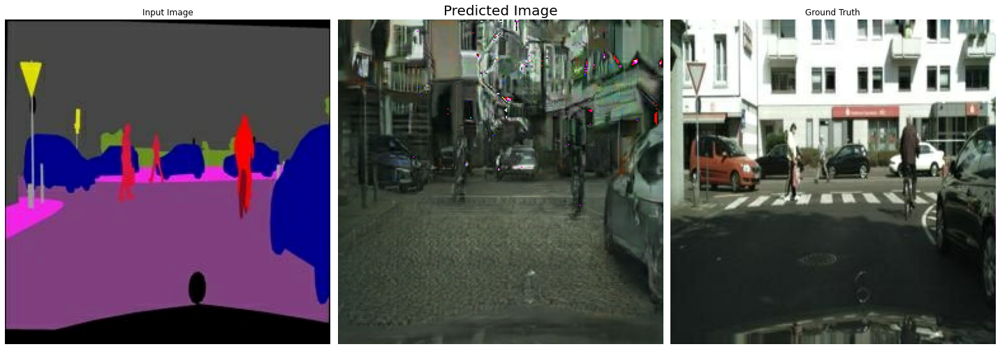

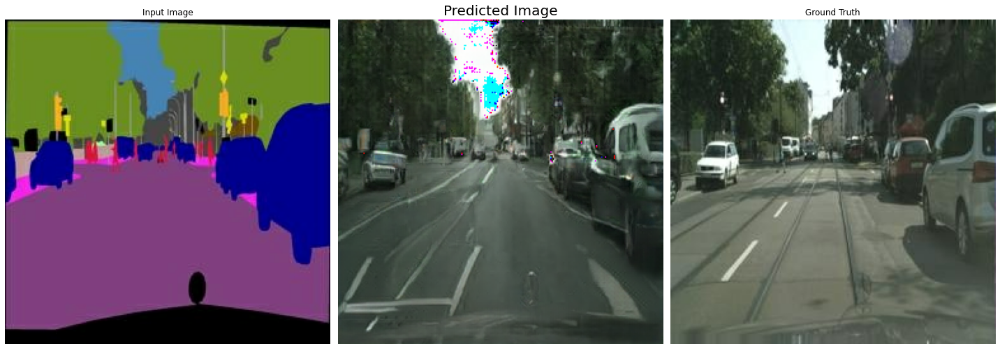

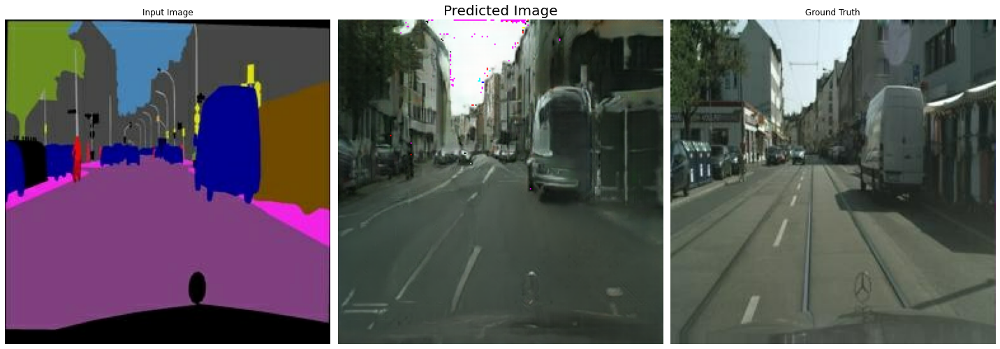

In [ ]:
draw_training_checkpoints_image(2)

## **🌿 09_결론**

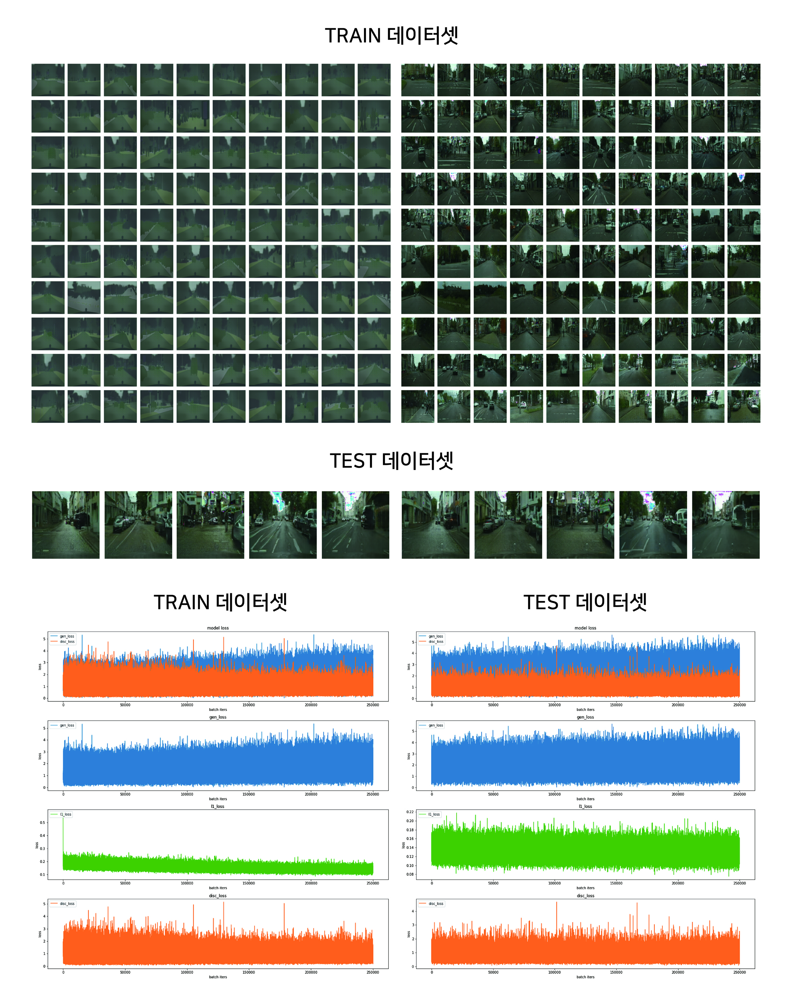

Epoch 1000으로 학습을 진행했다. 결과적으로 중간중간 뭉개진 경향이 있지만 생각보다 깔끔한 이미지를 생성하였고, 도로의 선도 완벽한 직선은 아니지만 직선에 가깝게 생성하는 모습을 보여주었다. 이미지 생성이 잘 된 것에 비해 그래프 생성 결과는 L1 loss이 하향되는 모습을 보이는 것 외에 나머지 부분은 거의 일정한 형태를 띄고 있어 약간 아쉽다. 

<hr>